### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

### Setup

In [5]:
cgi_csv = '../data/institutions_data_prepped.csv'

In [6]:
cgi_df = pd.read_csv(cgi_csv)

In [7]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforc

In [8]:
# Drop Region: Europe

In [9]:
cgi_df = cgi_df[cgi_df['Region: Europe'] != 1]

In [10]:
cgi_df['Region: Europe'].sum()

0

In [11]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforc

Note: CGI -> CGI *mechanisms*

In [12]:
cgi_only_df = cgi_df[cgi_df['CGI'].notna()]

In [13]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforc

In [14]:
cgi_mechanisms_list = [x for x in cgi_only_df.columns if 'cgis_include_' in x]
cgi_mechanisms_list

['access_cgis_include_matriarchy',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_frequent_and_or_regular_meetings',
 'enforcement_cgis_include_scrutiny_of_officials',
 'decision_making_cgis_include_turnover_rotation',
 'access_cgis_include_election',
 'enforcement_cgis_include_tribunal_court_',
 'decision_making_cgis_include_ratification_acclamation_only',
 'decision_making_cgis_include_agenda_setting',
 'decision_making_cgis_include_secret_ballot',
 'access_cgis_include_life_appointment',
 'access_cgis_include_gerontocracy',
 'decision_making_cgis_include_assembly_local',
 'decision_making_cgis_include_quorum',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'decision_making_cgis_include_magistrate_official',
 'decision_making_cgis_include_unanimity',
 'decision_making_cgis_include_council_local',
 'decision_making_cgis_include_board_commit

In [15]:
cgi_mechanisms_df = cgi_only_df[cgi_mechanisms_list]

In [16]:
cgi_mechanisms_df

,access_cgis_include_matriarchy,decision_making_cgis_include_consent,decision_making_cgis_include_frequent_and_or_regular_meetings,enforcement_cgis_include_scrutiny_of_officials,decision_making_cgis_include_turnover_rotation,access_cgis_include_election,enforcement_cgis_include_tribunal_court_,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_secret_ballot,access_cgis_include_life_appointment,access_cgis_include_gerontocracy,decision_making_cgis_include_assembly_local,decision_making_cgis_include_quorum,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_unanimity,decision_making_cgis_include_council_local,decision_making_cgis_include_board_committee,decision_making_cgis_include_deliberation,access_cgis_include_meritocracy,decision_making_cgis_include_council_central_,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_assembly_elite,access_cgis_include_heredity,decision_making_cgis_include_representation,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_majority_voting,decision_making_cgis_include_supermajority,decision_making_cgis_include_assembly_central,decision_making_cgis_include_remunerated_position,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_voting,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_delegation,access_cgis_include_property_requirement,enforcement_cgis_include_judicial_review,enforcement_cgis_include_litigation,access_cgis_include_patronage_for_office,access_cgis_include_age_boundaries,decision_making_cgis_include_oath,access_cgis_include_matrilineality,access_cgis_include_popularity_,access_cgis_include_blood_relations,decision_making_cgis_include_consultation,access_cgis_include_lottery_random_selection,decision_making_cgis_include_consensus,decision_making_cgis_include_vote_by_show_of_hands,enforcement_cgis_include_appeal,access_cgis_include_co-optation,decision_making_cgis_include_public_meetings,enforcement_cgis_include_criticism_mocking_joking
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
35,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
37,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
38,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
40,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
43,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
45,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
47,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
84,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [17]:
cgi_mechanisms_df.sum().sort_values(ascending=False)

decision_making_cgis_include_council_central_                           26
decision_making_cgis_include_council_local                              24
decision_making_cgis_include_assembly_central                           12
decision_making_cgis_include_consensus                                  12
decision_making_cgis_include_deliberation                               11
decision_making_cgis_include_representation                             11
enforcement_cgis_include_tribunal_court_                                 6
decision_making_cgis_include_assembly_local                              6
decision_making_cgis_include_frequent_and_or_regular_meetings            6
access_cgis_include_election                                             5
decision_making_cgis_include_consultation                                5
decision_making_cgis_include_assembly_elite                              5
access_cgis_include_meritocracy                                          5
decision_making_cgis_incl

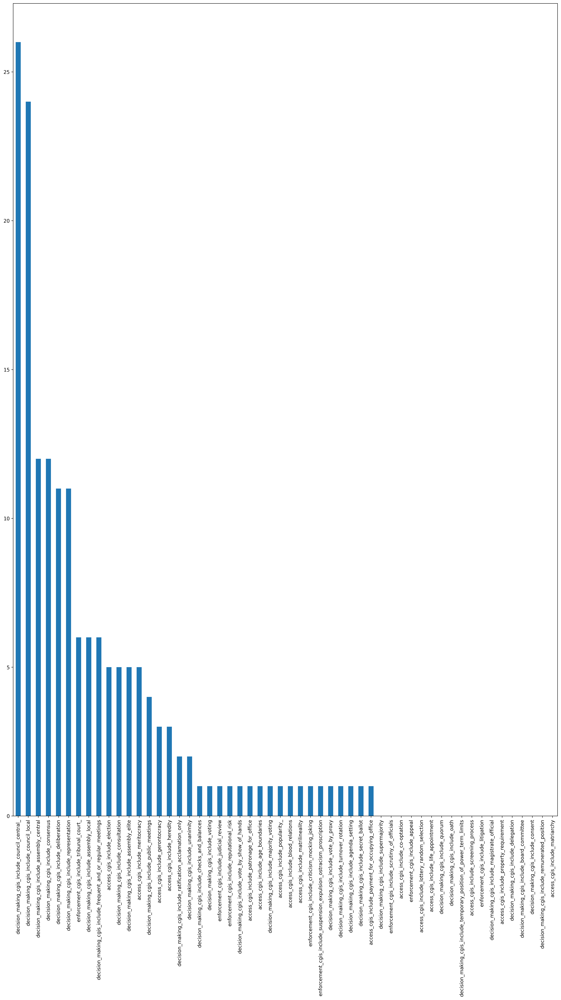

In [18]:
cgi_mechanisms_df.sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

plt.savefig('../fig/cgis_histogram.png')

TODO: 
  - comparative analysis b/n CGI mechanisms and non-CGI mechanisms

# CGI Mechanism Analysis 

In [19]:
# Select columns of interest

In [20]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_induction_rite_ceremony',
 'decision_making_mechanisms_include_assembly_elite',
 'access_mechanisms_include_patronage_for_office',
 'decision_making_mechanisms_include_supermajority',
 'decision_making_mechanisms_include_mandate',
 'access_mechanisms_include_gerontocracy',
 'decision_making_mechanisms_include_veto',
 'access_mechanisms_include_matriarchy',
 'decision_making_mechanisms_include_board_committee',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'decision_making_mechanisms_include_voting',
 'access_mechanisms_include_popularity_',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_secret_ballot',
 'decision_making_mechanisms_include_lobbying',
 

In [21]:
# Drop community mechanisms
mechanisms_list = [x for x in cgi_df.columns if x.startswith('mechanisms')]
mechanisms_list

[]

In [22]:
cgi_df.drop(columns=mechanisms_list, inplace=True)

In [23]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_induction_rite_ceremony',
 'decision_making_mechanisms_include_assembly_elite',
 'access_mechanisms_include_patronage_for_office',
 'decision_making_mechanisms_include_supermajority',
 'decision_making_mechanisms_include_mandate',
 'access_mechanisms_include_gerontocracy',
 'decision_making_mechanisms_include_veto',
 'access_mechanisms_include_matriarchy',
 'decision_making_mechanisms_include_board_committee',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'decision_making_mechanisms_include_voting',
 'access_mechanisms_include_popularity_',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_secret_ballot',
 'decision_making_mechanisms_include_lobbying',
 

## Normalized Correlation Matrix

In [24]:
data_plot = cgi_df.select_dtypes(include=[np.number])

In [25]:
data_plot.describe()

,Time span: Start,Time span: End,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_seizing_of_property,decision_making_mech

In [ ]:
data_plot

In [27]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_seizing_of_property,decision_making_mech

In [28]:
norm_corr.head()

,Time span: Start,Time span: End,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_seizing_of_property,decision_making_mech

In [29]:
norm_corr['decision_making_mechanisms_include_assembly_central'].sort_values(ascending=False)

decision_making_mechanisms_include_assembly_central                                1.000000
Geography: Africa North                                                            0.619560
access_mechanisms_include_screening_process                                        0.569434
enforcement_mechanisms_include_military_force                                      0.569434
Geography: Asia, China                                                             0.569434
Size: 10,000,000+                                                                  0.557126
decision_making_mechanisms_include_autocratic_leader_chief_bound                   0.556033
decision_making_mechanisms_include_rule_of_law                                     0.555864
enforcement_mechanisms_include_mediation                                           0.552393
decision_making_mechanisms_include_remunerated_position                            0.531177
enforcement_mechanisms_include_tribunal_court_                                  

# Visualize and Sort CGI Correlations

In [30]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.show()
plt.savefig('../fig/cgis_triangle_correlations.png')

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_8052/2314798905.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


<Figure size 1920x1440 with 0 Axes>

In [31]:
cgis_list = [x for x in cgi_df.columns if 'cgis_' in x]
cgis_list

['access_cgis_include_matriarchy',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_frequent_and_or_regular_meetings',
 'enforcement_cgis_include_scrutiny_of_officials',
 'decision_making_cgis_include_turnover_rotation',
 'access_cgis_include_election',
 'enforcement_cgis_include_tribunal_court_',
 'decision_making_cgis_include_ratification_acclamation_only',
 'decision_making_cgis_include_agenda_setting',
 'decision_making_cgis_include_secret_ballot',
 'access_cgis_include_life_appointment',
 'access_cgis_include_gerontocracy',
 'decision_making_cgis_include_assembly_local',
 'decision_making_cgis_include_quorum',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'decision_making_cgis_include_magistrate_official',
 'decision_making_cgis_include_unanimity',
 'decision_making_cgis_include_council_local',
 'decision_making_cgis_include_board_commit

In [32]:
cgis_df = norm_corr[cgis_list]

In [33]:
cgis_df

,access_cgis_include_matriarchy,decision_making_cgis_include_consent,decision_making_cgis_include_frequent_and_or_regular_meetings,enforcement_cgis_include_scrutiny_of_officials,decision_making_cgis_include_turnover_rotation,access_cgis_include_election,enforcement_cgis_include_tribunal_court_,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_secret_ballot,access_cgis_include_life_appointment,access_cgis_include_gerontocracy,decision_making_cgis_include_assembly_local,decision_making_cgis_include_quorum,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_unanimity,decision_making_cgis_include_council_local,decision_making_cgis_include_board_committee,decision_making_cgis_include_deliberation,access_cgis_include_meritocracy,decision_making_cgis_include_council_central_,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_assembly_elite,access_cgis_include_heredity,decision_making_cgis_include_representation,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_majority_voting,decision_making_cgis_include_supermajority,decision_making_cgis_include_assembly_central,decision_making_cgis_include_remunerated_position,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_voting,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_delegation,access_cgis_include_property_requirement,enforcement_cgis_include_judicial_review,enforcement_cgis_include_litigation,access_cgis_include_patronage_for_office,access_cgis_include_age_boundaries,decision_making_cgis_include_oath,access_cgis_include_matrilineality,access_cgis_include_popularity_,access_cgis_include_blood_relations,decision_making_cgis_include_consultation,access_cgis_include_lottery_random_selection,decision_making_cgis_include_consensus,decision_making_cgis_include_vote_by_show_of_hands,enforcement_cgis_include_appeal,access_cgis_include_co-optation,decision_making_cgis_include_public_meetings,enforcement_cgis_include_criticism_mocking_joking
Time span: Start,NaN,NaN,0.086997,NaN,0.055516,0.101909,0.008027,-0.010507,0.036283,0.055516,NaN,0.078187,0.068591,NaN,0.055411,0.035463,NaN,NaN,-0.005204,0.177468,NaN,0.082510,0.107056,-0.027859,0.055082,0.050293,0.081071,0.076295,NaN,0.055411,NaN,-0.152707,NaN,0.033727,0.041626,0.035463,NaN,NaN,0.036283,NaN,0.052909,0.055516,NaN,0.035463,0.036283,0.034845,-0.058847,NaN,0.169987,0.055516,NaN,NaN,-0.027868,0.055411
Time span: End,NaN,NaN,0.071108,NaN,0.043789,0.107183,-0.002607,-0.020730,0.053512,0.043789,NaN,0.084559,0.047769,NaN,0.043892,0.053655,NaN,NaN,-0.002977,0.170465,NaN,0.090584,0.108114,0.004954,0.044208,0.044775,0.083682,0.090712,NaN,0.043892,NaN,-0.116850,NaN,0.053904,0.052162,0.053655,NaN,NaN,0.053512,NaN,0.046105,0.043789,NaN,0.053655,0.053512,0.053751,-0.032365,NaN,0.167443,0.043789,NaN,NaN,-0.013887,0.043892
access_mechanisms_include_enfranchisement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
access_mechanisms_include_induction_rite_ceremony,NaN,NaN,-0.015281,NaN,-0.006216,-0.013718,0.324245,-0.008614,-0.006216,-0.006216,NaN,-0.010707,-0.015261,NaN,-0.006216,-0.006216,NaN,NaN,-0.008626,-0.031672,NaN,0.247950,0.354875,0.093009,-0.006216,-0.013738,-0.010746,-0.020584,NaN,-0.006216,NaN,-0.018287,NaN,-0.006216,0.705554,-0.006216,NaN,NaN,-0.006216,NaN,-0.006216,-0.006216,NaN,-0.006216,-0.006216,-0.006216,-0.012661,NaN,0.229210,-0.006216,NaN,NaN,-0.011027,-0.006216
decision_making_mechanisms_include_assembly_elite,NaN,NaN,0.044005,NaN,-0.029801,0.130712,0.023536,0.230755,-0.029801,-0.029801,NaN,0.08215

In [34]:
query_cgis_df = cgis_df.transpose()

In [35]:
query_cgis_df.head()

,Time span: Start,Time span: End,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_seizing_of_property,decision_making_mech

## Time x Region x Size for CGIs

In [36]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [37]:
region_cols = [r for r in list(cgi_df) if 'Region: ' in r] 

In [38]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [39]:
list(cgi_df.columns)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_induction_rite_ceremony',
 'decision_making_mechanisms_include_assembly_elite',
 'access_mechanisms_include_patronage_for_office',
 'decision_making_mechanisms_include_supermajority',
 'decision_making_mechanisms_include_mandate',
 'access_mechanisms_include_gerontocracy',
 'decision_making_mechanisms_include_veto',
 'access_mechanisms_include_matriarchy',
 'decision_making_mechanisms_include_board_committee',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'decision_making_mechanisms_include_voting',
 'access_mechanisms_include_popularity_',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_secret_ballot',
 'decision_making_mechanisms_include_lobbying',
 

In [40]:
access_cgis = [x for x in cgi_df.columns if 'access_cgis_' in x]

In [41]:
decision_making_cgis = [x for x in cgi_df.columns if 'decision_making_cgis_' in x]

In [42]:
enforcement_cgis = [x for x in cgi_df.columns if 'enforcement_cgis_' in x]

## Time x CGIs

In [43]:
time_cgis = query_cgis_df[time_span_cols]
time_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_matriarchy,NaN,NaN,NaN
decision_making_cgis_include_consent,NaN,NaN,NaN
decision_making_cgis_include_frequent_and_or_regular_meetings,0.086997,0.071108,-0.081102
enforcement_cgis_include_scrutiny_of_officials,NaN,NaN,NaN
decision_making_cgis_include_turnover_rotation,0.055516,0.043789,-0.056260
access_cgis_include_election,0.101909,0.107183,-0.027181
enforcement_cgis_include_tribunal_court_,0.008027,-0.002607,-0.033511
decision_making_cgis_include_ratification_acclamation_only,-0.010507,-0.020730,-0.024678
decision_making_cgis_include_agenda_setting,0.036283,0.053512,0.033906
decision_making_cgis_include_secret_ballot,0.055516,0.043789,-0.056260


In [44]:
plt.figure(figsize=(40, 30))

sns.heatmap(time_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/cgis_time.png')

<Figure size 1920x1440 with 0 Axes>

### Time x CGIs: Access, Decision Making, Enforcement

In [45]:
access_cgis

['access_cgis_include_matriarchy',
 'access_cgis_include_election',
 'access_cgis_include_life_appointment',
 'access_cgis_include_gerontocracy',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'access_cgis_include_meritocracy',
 'access_cgis_include_heredity',
 'access_cgis_include_property_requirement',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_age_boundaries',
 'access_cgis_include_matrilineality',
 'access_cgis_include_popularity_',
 'access_cgis_include_blood_relations',
 'access_cgis_include_lottery_random_selection',
 'access_cgis_include_co-optation']

In [46]:
time_access_cgis = time_cgis.loc[access_cgis]

In [47]:
time_access_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_matriarchy,NaN,NaN,NaN
access_cgis_include_election,0.101909,0.107183,-0.027181
access_cgis_include_life_appointment,NaN,NaN,NaN
access_cgis_include_gerontocracy,0.078187,0.084559,-0.014253
access_cgis_include_payment_for_occupying_office,0.035463,0.053655,0.036979
access_cgis_include_screening_process,NaN,NaN,NaN
access_cgis_include_meritocracy,0.107056,0.108114,-0.041281
access_cgis_include_heredity,0.081071,0.083682,-0.026122
access_cgis_include_property_requirement,NaN,NaN,NaN
access_cgis_include_patronage_for_office,0.052909,0.046105,-0.041206


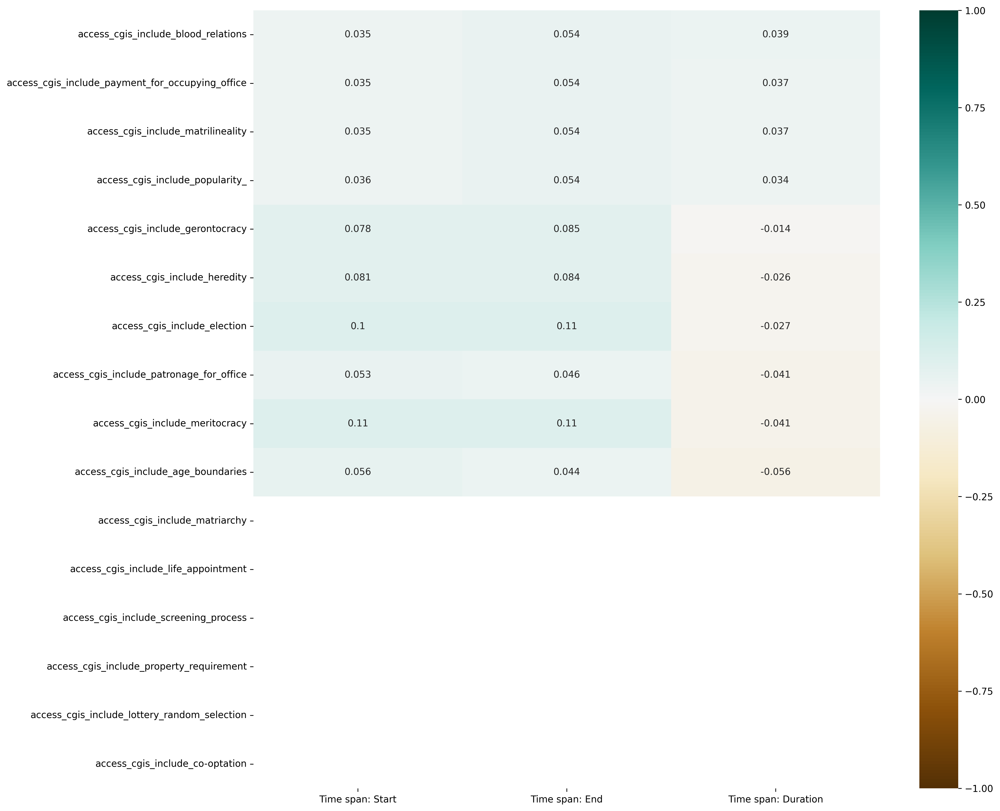

<Figure size 1920x1440 with 0 Axes>

In [48]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/time_access_cgis.png')

In [49]:
time_decision_making_cgis = time_cgis.loc[decision_making_cgis]

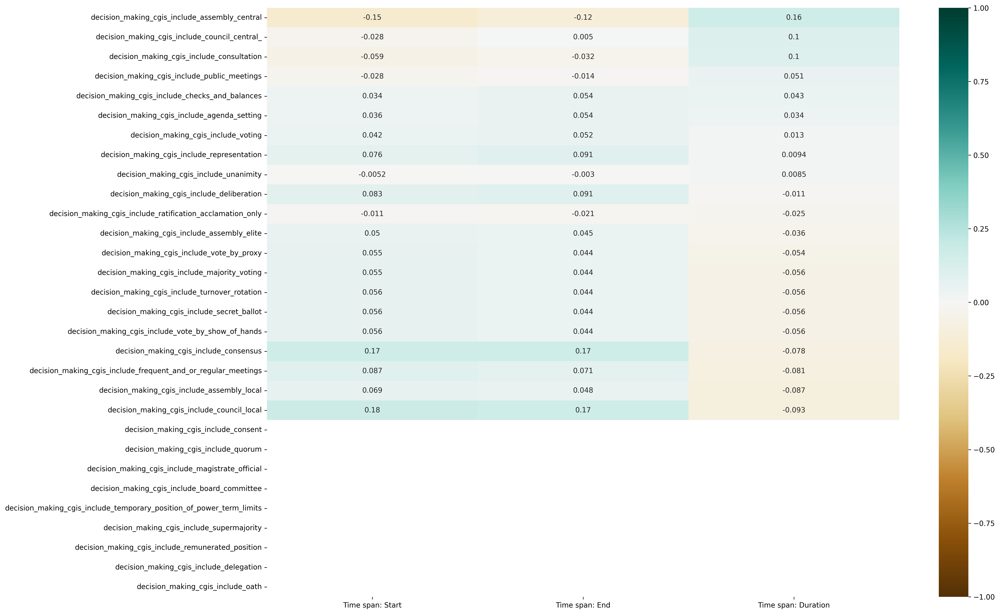

<Figure size 1920x1440 with 0 Axes>

In [50]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/time_decision_making_cgis.png')

In [51]:
time_enforcement_cgis = time_cgis.loc[enforcement_cgis]

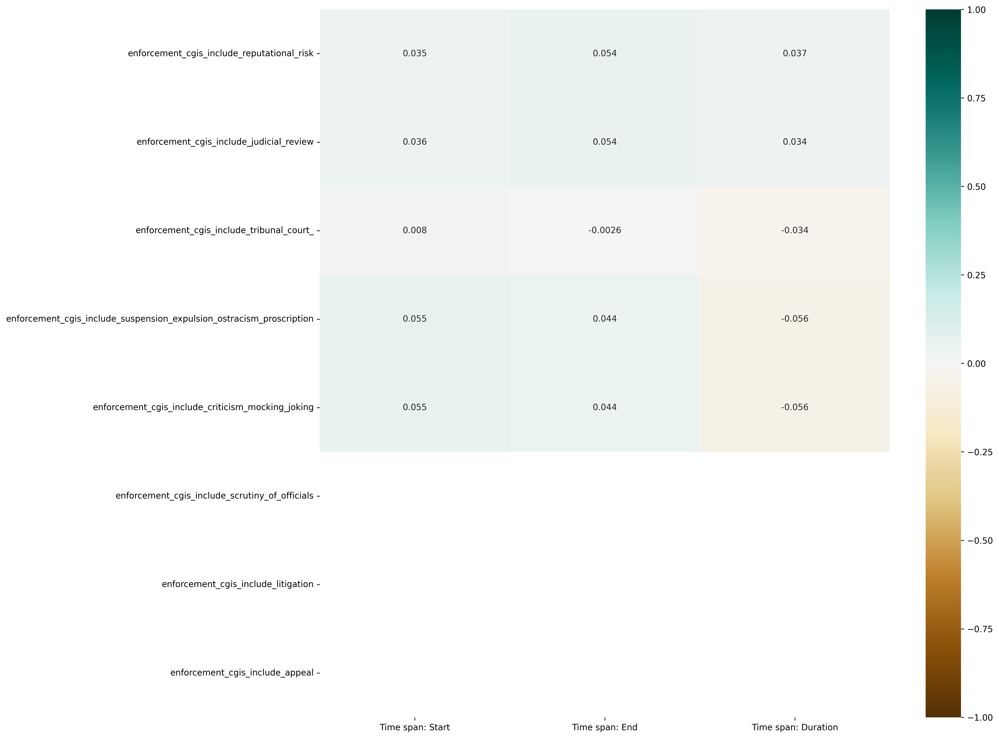

<Figure size 1920x1440 with 0 Axes>

In [52]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_enforcement_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/time_enforcement_cgis.png')

## Region x CGIs

In [53]:
region_cgis = query_cgis_df[region_cols]
region_cgis

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
access_cgis_include_matriarchy,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_consent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_frequent_and_or_regular_meetings,-0.042252,NaN,-0.069681,-0.069215,0.085829,0.054570,-0.010782,0.221909
enforcement_cgis_include_scrutiny_of_officials,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_turnover_rotation,-0.025318,NaN,-0.041990,-0.028156,-0.030847,0.220066,-0.004386,-0.007630
access_cgis_include_election,-0.017269,NaN,0.019738,-0.062134,-0.003850,0.052551,-0.009679,-0.016838
enforcement_cgis_include_tribunal_court_,-0.008406,NaN,-0.046964,0.037212,-0.075629,0.116964,-0.010753,-0.018707
decision_making_cgis_include_ratification_acclamation_only,-0.035085,NaN,0.051444,0.035749,-0.042747,-0.021266,-0.006078,-0.010574
decision_making_cgis_include_agenda_setting,-0.025318,NaN,-0.041990,-0.028156,0.155645,-0.015346,-0.004386,-0.007630
decision_making_cgis_include_secret_ballot,-0.025318,NaN,-0.041990,-0.028156,-0.030847,0.220066,-0.004386,-0.007630


In [54]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_cgis = region_cgis[cols_to_move + [col for col in region_cgis.columns if col not in cols_to_move ]]

In [55]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.savefig('../fig/cgis_region.png')

### Region x CGIs: Access, Decision Making, Enforcement

In [56]:
region_access_cgis = region_cgis.loc[access_cgis]

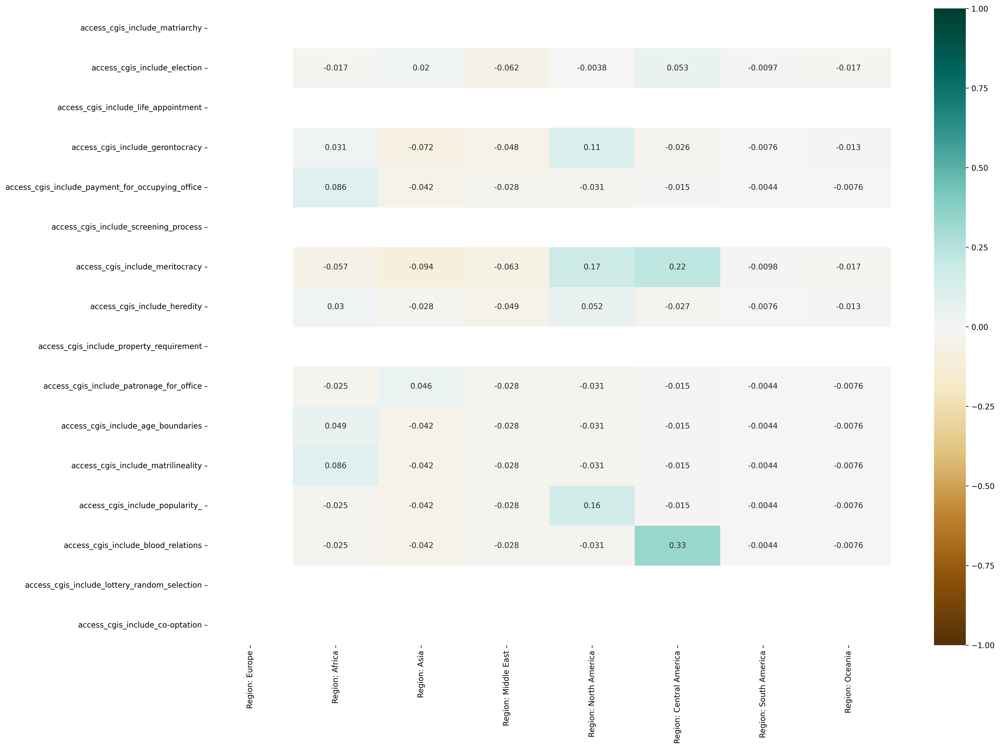

<Figure size 1920x1440 with 0 Axes>

In [57]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_access_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/region_access_cgis.png')

In [58]:
region_decision_making_cgis = region_cgis.loc[decision_making_cgis]

In [59]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_decision_making_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/region_decision_making_cgis.png')

<Figure size 1920x1440 with 0 Axes>

In [60]:
region_enforcement_cgis = region_cgis.loc[enforcement_cgis]

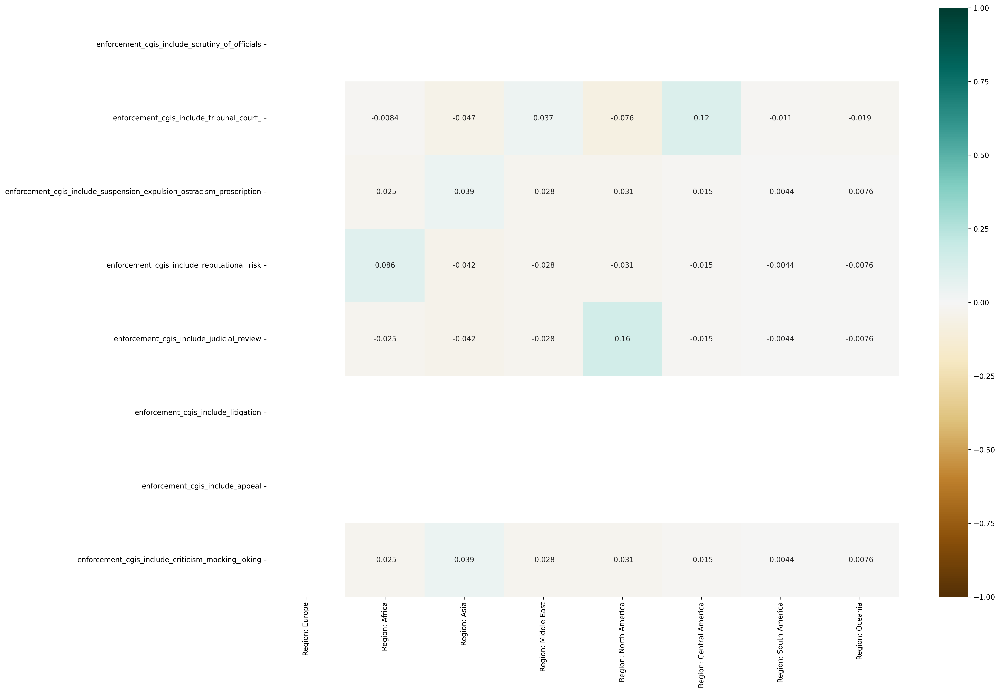

<Figure size 1920x1440 with 0 Axes>

In [61]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_enforcement_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/region_enforcement_cgis.png')

## Size x CGIs

In [62]:
size_cgis = query_cgis_df[size_cols]

In [63]:
plt.figure(figsize=(40, 30))

sns.heatmap(size_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/cgis_size.png')

<Figure size 1920x1440 with 0 Axes>

### Size x CGIs: Access, Decision Making, Enforcement

In [64]:
size_access_cgis = size_cgis.loc[access_cgis]

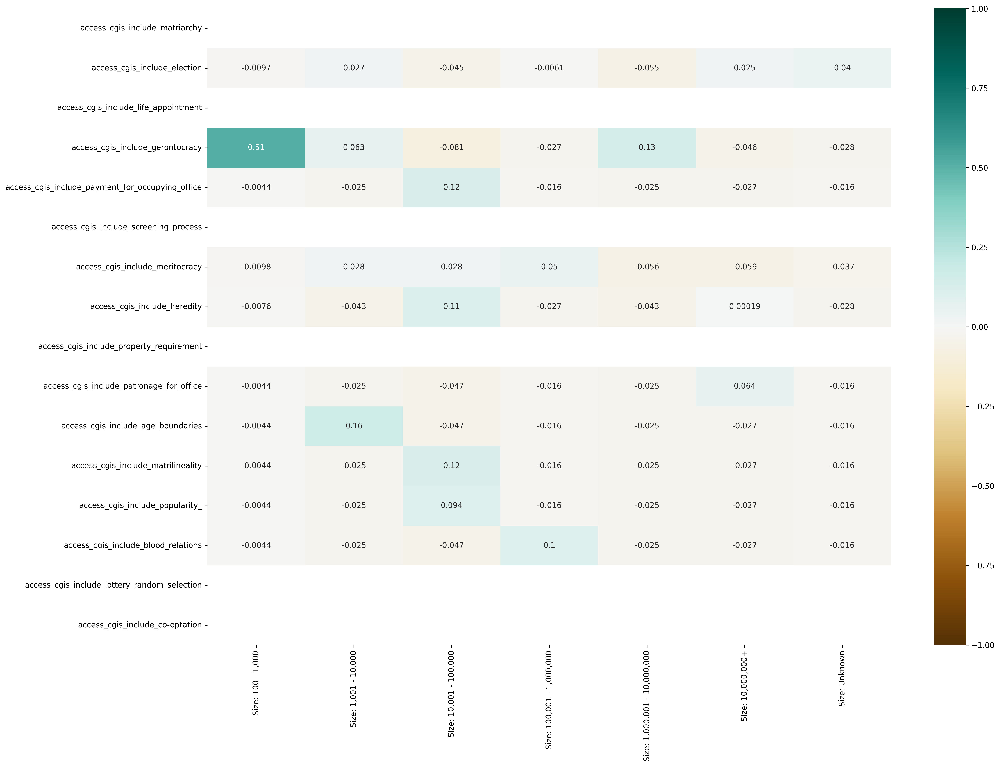

<Figure size 1920x1440 with 0 Axes>

In [65]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_access_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/size_access_cgis.png')

In [66]:
size_decision_making_cgis = size_cgis.loc[decision_making_cgis]

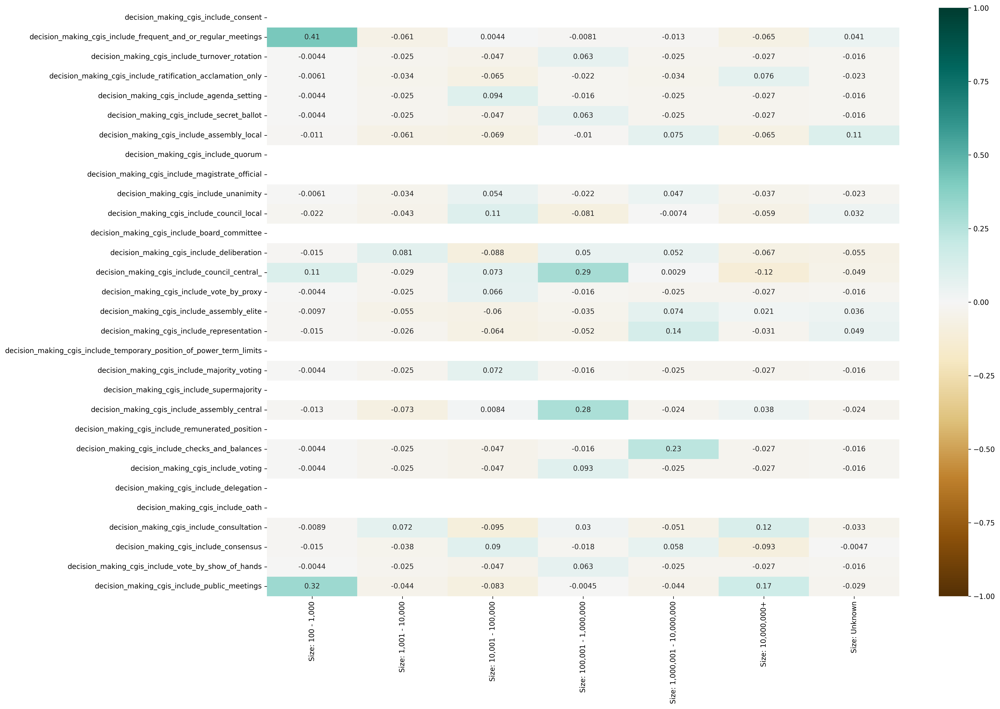

<Figure size 1920x1440 with 0 Axes>

In [67]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_decision_making_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/size_decision_making_cgis.png')

In [68]:
size_enforcement_cgis = size_cgis.loc[enforcement_cgis]

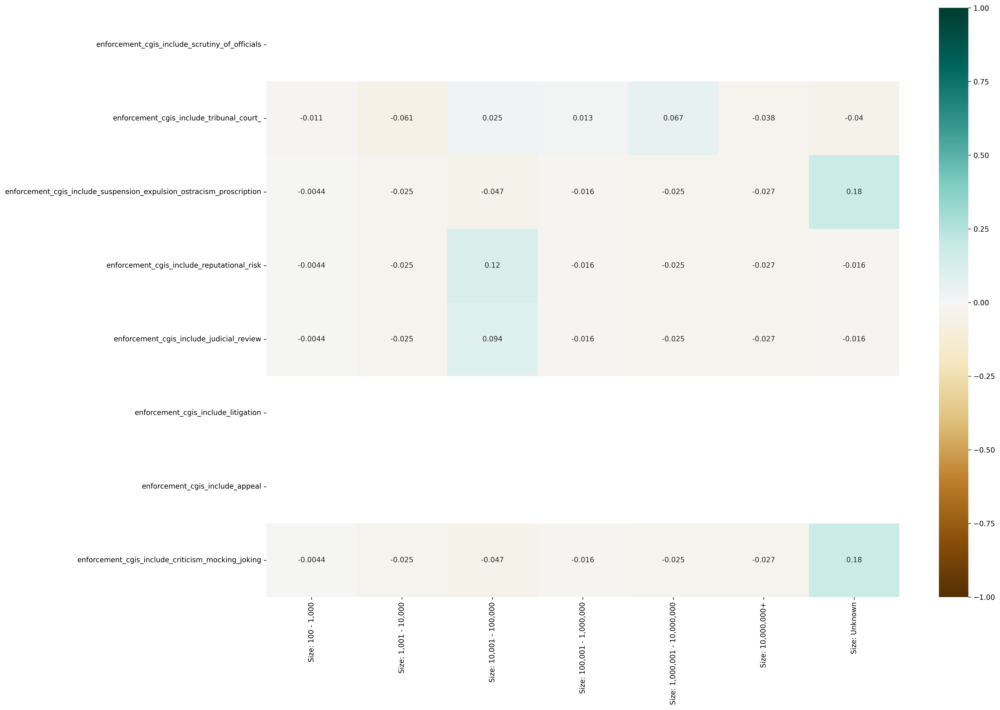

<Figure size 1920x1440 with 0 Axes>

In [69]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_enforcement_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/size_enforcement_cgis.png')

# Sorted positive and negative correlations

In [70]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [77]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [78]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

enforcement_mechanisms_include_military_force                         access_mechanisms_include_screening_process          1.0
decision_making_mechanisms_include_delegation                         Geography: Asia, Japan                               1.0
enforcement_cgis_include_suspension_expulsion_ostracism_proscription  enforcement_cgis_include_criticism_mocking_joking    1.0
decision_making_mechanisms_include_mandate                            Geography: Middle East, Mesopotamia, Babylonia       1.0
enforcement_mechanisms_include_litigation                             decision_making_mechanisms_include_petition          1.0
                                                                                                                          ... 
enforcement_cgis_include_appeal                                       access_cgis_include_co-optation                      NaN
                                                                      decision_making_cgis_include_public_meeti

In [79]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/cgis_all_correlations_no_europe.csv')

In [74]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: Start                                                                 decision_making_mechanisms_include_magistrate_official             -0.639583
Time span: End                                                                   decision_making_mechanisms_include_magistrate_official             -0.590062
                                                                                 Region: Middle East                                                -0.587606
                                                                                 Geography: Middle East                                             -0.558385
Time span: Start                                                                 decision_making_mechanisms_include_assembly_central                -0.553703
                                                                                 Time span: Duration                                                -0.541077
                                                    

In [75]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/cgis_negative_correlations.csv')